In [3]:
import pickle
import pandas as pd
import numpy as np
from scipy.stats import ks_2samp
import re
import matplotlib.pyplot as plt
import scipy.stats as st

In [15]:
def ks_plot_comp(data_1, data_2):
    plt.figure(figsize=(12, 7))
    plt.scatter(data_1, range(len(data_1)), label="base loss", alpha=0.3, s=2)
    plt.scatter(data_2, range(len(data_2)), label="attack loss", alpha=0.3, s=2)
    plt.legend('top right')
    plt.title('Comparing 2 data distributions for KS-Test')
    plt.show()

In [8]:
with open("output/base_loss.pkl", "rb") as f:
    base_loss_values = pickle.load(f)

### PGDl2 + base

In [10]:
%%capture losses
!python ../run_reconstruct_mae.py --two_data_paths True --data_path1 "c:\Users\Albert Wen\ml_security\ImageNet-Data\val" --data_path2 "\\wsl$\Ubuntu\home\awen\pgd_l2" --mask_ratio 0.75 --model pretrain_mae_base_patch16_224 --batch_size 1 --resume ../output/reconstruct_mae_pretrain_model/checkpoint-399.pth --mlp_resume ../output/reconstruct_mae_pretrain_model/mlp-checkpoint-399.pth --output_dir ../output/reconstruct_mae_pretrain_model/ --eval --num_workers 1

In [12]:
output_lines = losses.stdout.split('\n')

pattern = re.compile('loss: (\d.\d*) ')

epoch_lines = [x for x in output_lines if x[0:5] == 'Epoch']
mixed_losses = [float(pattern.findall(x)[0]) for x in epoch_lines[:-1] if pattern.findall(x) != []]

In [13]:
with open("output/pgdl2_mixed.pkl", "wb") as f:
    pickle.dump(mixed_losses, f)

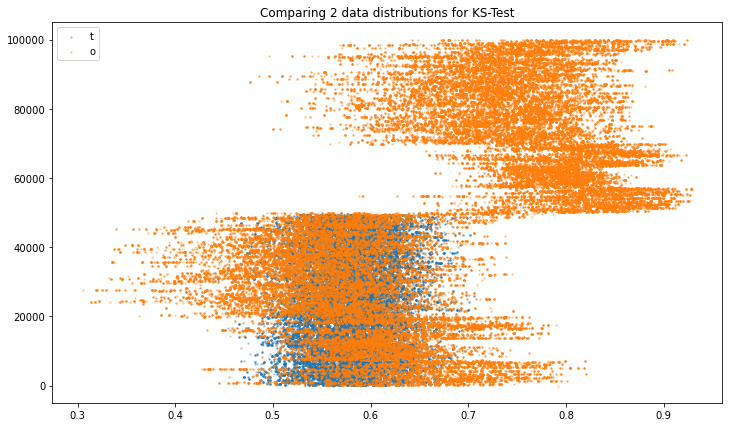

In [16]:
ks_plot_comp(base_loss_values, mixed_losses)

### PGD8 + Base

In [5]:
%%capture losses
!python ../run_reconstruct_mae.py --two_data_paths True --data_path1 "c:\Users\Albert Wen\ml_security\ImageNet-Data\val" --data_path2 "\\wsl$\Ubuntu\home\awen\pgd_8" --mask_ratio 0.75 --model pretrain_mae_base_patch16_224 --batch_size 1 --resume ../output/reconstruct_mae_pretrain_model/checkpoint-399.pth --mlp_resume ../output/reconstruct_mae_pretrain_model/mlp-checkpoint-399.pth --output_dir ../output/reconstruct_mae_pretrain_model/ --eval --num_workers 1

Not using distributed mode
Namespace(batch_size=1, epochs=300, save_ckpt_freq=20, model='pretrain_mae_base_patch16_224', finetune='', model_key='model|module', model_prefix='', init_scale=0.001, use_mean_pooling=True, mask_ratio=0.75, input_size=224, drop_path=0.0, normlize_target=True, opt='adamw', opt_eps=1e-08, opt_betas=None, clip_grad=None, momentum=0.9, weight_decay=0.05, weight_decay_end=None, lr=0.00015, warmup_lr=1e-06, min_lr=1e-05, warmup_epochs=40, warmup_steps=-1, color_jitter=0.0, train_interpolation='bicubic', two_data_paths=True, data_path1='c:\\Users\\Albert Wen\\ml_security\\ImageNet-Data\\val', data_path2='\\\\wsl$\\Ubuntu\\home\\awen\\pgd_8', src_data_path='/datasets01/imagenet_full_size/061417/train', tar_data_path='/datasets01/imagenet_full_size/061417/train', imagenet_default_mean_and_std=True, output_dir='../output/reconstruct_mae_pretrain_model/', log_dir=None, device='cuda', seed=0, resume='../output/reconstruct_mae_pretrain_model/checkpoint-399.pth', mlp_resu


          (fc2): Linear(in_features=3072, out_features=768, bias=True)
          (drop): Dropout(p=0.0, inplace=False)
        )
      )
      (4): Block(
        (norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=768, out_features=2304, bias=False)
          (attn_drop): Dropout(p=0.0, inplace=False)
          (proj): Linear(in_features=768, out_features=768, bias=True)
          (proj_drop): Dropout(p=0.0, inplace=False)
        )
        (drop_path): Identity()
        (norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): Mlp(
          (fc1): Linear(in_features=768, out_features=3072, bias=True)
          (act): GELU()
          (fc2): Linear(in_features=3072, out_features=768, bias=True)
          (drop): Dropout(p=0.0, inplace=False)
        )
      )
      (5): Block(
        (norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv):

In [6]:
output_lines = losses.stdout.split('\n')

pattern = re.compile('loss: (\d.\d*) ')

epoch_lines = [x for x in output_lines if x[0:5] == 'Epoch']
mixed_losses = [float(pattern.findall(x)[0]) for x in epoch_lines[:-1] if pattern.findall(x) != []]

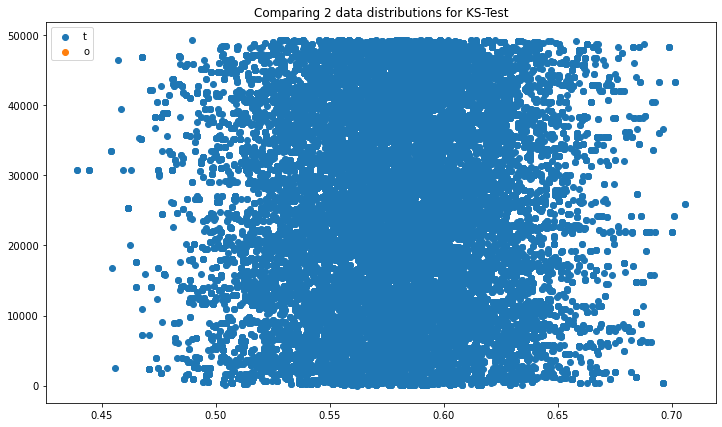

In [9]:
ks_plot_comp(base_loss_values, mixed_losses)

In [ ]:
# with open("output/pgd8_mixed.pkl", "wb") as f:
#     pickle.dump(mixed_losses, f)

### FGSM4 + Base

In [32]:
%%capture losses
!python ../run_reconstruct_mae.py --two_data_paths True --data_path1 "c:\Users\Albert Wen\ml_security\ImageNet-Data\val" --data_path2 "\\wsl$\Ubuntu\home\awen\fgsm_4" --mask_ratio 0.75 --model pretrain_mae_base_patch16_224 --batch_size 1 --resume ../output/reconstruct_mae_pretrain_model/checkpoint-399.pth --mlp_resume ../output/reconstruct_mae_pretrain_model/mlp-checkpoint-399.pth --output_dir ../output/reconstruct_mae_pretrain_model/ --eval --num_workers 1

Not using distributed mode
Namespace(batch_size=1, epochs=300, save_ckpt_freq=20, model='pretrain_mae_base_patch16_224', finetune='', model_key='model|module', model_prefix='', init_scale=0.001, use_mean_pooling=True, mask_ratio=0.75, input_size=224, drop_path=0.0, normlize_target=True, opt='adamw', opt_eps=1e-08, opt_betas=None, clip_grad=None, momentum=0.9, weight_decay=0.05, weight_decay_end=None, lr=0.00015, warmup_lr=1e-06, min_lr=1e-05, warmup_epochs=40, warmup_steps=-1, color_jitter=0.0, train_interpolation='bicubic', two_data_paths=True, data_path1='c:\\Users\\Albert Wen\\ml_security\\ImageNet-Data\\val', data_path2='\\\\wsl$\\Ubuntu\\home\\awen\\fgsm_4', src_data_path='/datasets01/imagenet_full_size/061417/train', tar_data_path='/datasets01/imagenet_full_size/061417/train', imagenet_default_mean_and_std=True, output_dir='../output/reconstruct_mae_pretrain_model/', log_dir=None, device='cuda', seed=0, resume='../output/reconstruct_mae_pretrain_model/checkpoint-399.pth', mlp_res

In [33]:
output_lines = losses.stdout.split('\n')

pattern = re.compile('loss: (\d.\d*) ')

epoch_lines = [x for x in output_lines if x[0:5] == 'Epoch']
mixed_losses = [float(pattern.findall(x)[0]) for x in epoch_lines[:-1] if pattern.findall(x) != []]


          (fc1): Linear(in_features=768, out_features=3072, bias=True)
          (act): GELU()
          (fc2): Linear(in_features=3072, out_features=768, bias=True)
          (drop): Dropout(p=0.0, inplace=False)
        )
      )
      (6): Block(
        (norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=768, out_features=2304, bias=False)
          (attn_drop): Dropout(p=0.0, inplace=False)
          (proj): Linear(in_features=768, out_features=768, bias=True)
          (proj_drop): Dropout(p=0.0, inplace=False)
        )
        (drop_path): Identity()
        (norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): Mlp(
          (fc1): Linear(in_features=768, out_features=3072, bias=True)
          (act): GELU()
          (fc2): Linear(in_features=3072, out_features=768, bias=True)
          (drop): Dropout(p=0.0, inplace=False)
        )
      )
      (7): Block(
        (norm1): La


Epoch: [1]  [   812/100000]  eta: 1:09:56  loss: 0.5899 (0.6156)  acc1: 100.0000 (100.0000)  acc5: 100.0000 (100.0000)  time: 0.0234  data: 0.0000  max mem: 1721
Epoch: [1]  [   813/100000]  eta: 1:09:54  loss: 0.5899 (0.6156)  acc1: 100.0000 (100.0000)  acc5: 100.0000 (100.0000)  time: 0.0234  data: 0.0000  max mem: 1721
Epoch: [1]  [   814/100000]  eta: 1:09:52  loss: 0.5899 (0.6156)  acc1: 100.0000 (100.0000)  acc5: 100.0000 (100.0000)  time: 0.0237  data: 0.0000  max mem: 1721
Epoch: [1]  [   815/100000]  eta: 1:09:50  loss: 0.5899 (0.6156)  acc1: 100.0000 (100.0000)  acc5: 100.0000 (100.0000)  time: 0.0237  data: 0.0000  max mem: 1721
Epoch: [1]  [   816/100000]  eta: 1:09:48  loss: 0.5693 (0.6155)  acc1: 100.0000 (100.0000)  acc5: 100.0000 (100.0000)  time: 0.0238  data: 0.0000  max mem: 1721
Epoch: [1]  [   817/100000]  eta: 1:09:45  loss: 0.5666 (0.6153)  acc1: 100.0000 (100.0000)  acc5: 100.0000 (100.0000)  time: 0.0234  data: 0.0000  max mem: 1721
Epoch: [1]  [   818/100000]

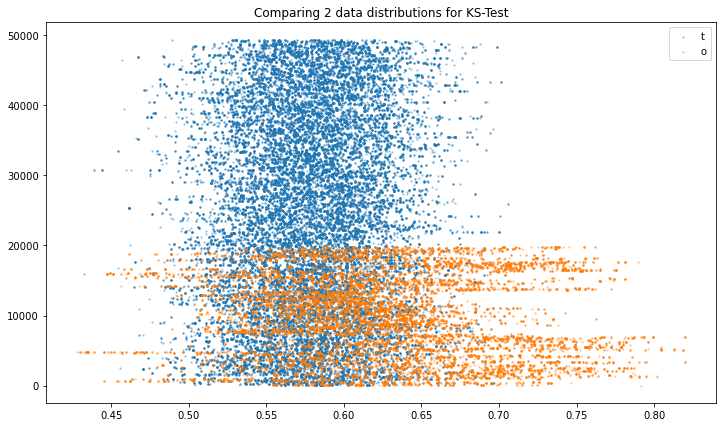

In [31]:
ks_plot_comp(base_loss_values, mixed_losses)

In [29]:
with open("output/fgsm4_mixed.pkl", "wb") as f:
    pickle.dump(mixed_losses, f)

### FGSM8 + Base

In [17]:
%%capture losses
!python ../run_reconstruct_mae.py --two_data_paths True --data_path1 "c:\Users\Albert Wen\ml_security\ImageNet-Data\val" --data_path2 "\\wsl$\Ubuntu\home\awen\fgsm_8" --mask_ratio 0.75 --model pretrain_mae_base_patch16_224 --batch_size 1 --resume ../output/reconstruct_mae_pretrain_model/checkpoint-399.pth --mlp_resume ../output/reconstruct_mae_pretrain_model/mlp-checkpoint-399.pth --output_dir ../output/reconstruct_mae_pretrain_model/ --eval --num_workers 1

Epoch: [1]  [ 49409/100000]  eta: 0:20:59  loss: 0.6187 (0.5839)  acc1: 100.0000 (99.9413)  acc5: 100.0000 (100.0000)  time: 0.0231  data: 0.0002  max mem: 1721
Epoch: [1]  [ 49410/100000]  eta: 0:20:59  loss: 0.6173 (0.5839)  acc1: 100.0000 (99.9413)  acc5: 100.0000 (100.0000)  time: 0.0230  data: 0.0002  max mem: 1721
Epoch: [1]  [ 49411/100000]  eta: 0:20:59  loss: 0.6173 (0.5839)  acc1: 100.0000 (99.9413)  acc5: 100.0000 (100.0000)  time: 0.0227  data: 0.0002  max mem: 1721
Epoch: [1]  [ 49412/100000]  eta: 0:20:59  loss: 0.6187 (0.5839)  acc1: 100.0000 (99.9413)  acc5: 100.0000 (100.0000)  time: 0.0227  data: 0.0002  max mem: 1721
Epoch: [1]  [ 49413/100000]  eta: 0:20:59  loss: 0.6187 (0.5839)  acc1: 100.0000 (99.9413)  acc5: 100.0000 (100.0000)  time: 0.0225  data: 0.0002  max mem: 1721
Epoch: [1]  [ 49414/100000]  eta: 0:20:59  loss: 0.6266 (0.5839)  acc1: 100.0000 (99.9413)  acc5: 100.0000 (100.0000)  time: 0.0226  data: 0.0001  max mem: 1721
Epoch: [1]  [ 49415/100000]  eta: 

In [18]:
output_lines = losses.stdout.split('\n')

pattern = re.compile('loss: (\d.\d*) ')

epoch_lines = [x for x in output_lines if x[0:5] == 'Epoch']
mixed_losses = [float(pattern.findall(x)[0]) for x in epoch_lines[:-1] if pattern.findall(x) != []]


Epoch: [1]  [ 49745/100000]  eta: 0:20:50  loss: 0.6679 (0.5844)  acc1: 100.0000 (99.9417)  acc5: 100.0000 (100.0000)  time: 0.0249  data: 0.0001  max mem: 1721
Epoch: [1]  [ 49746/100000]  eta: 0:20:50  loss: 0.6679 (0.5844)  acc1: 100.0000 (99.9417)  acc5: 100.0000 (100.0000)  time: 0.0250  data: 0.0002  max mem: 1721
Epoch: [1]  [ 49747/100000]  eta: 0:20:50  loss: 0.6679 (0.5844)  acc1: 100.0000 (99.9417)  acc5: 100.0000 (100.0000)  time: 0.0249  data: 0.0002  max mem: 1721
Epoch: [1]  [ 49748/100000]  eta: 0:20:50  loss: 0.6571 (0.5844)  acc1: 100.0000 (99.9417)  acc5: 100.0000 (100.0000)  time: 0.0250  data: 0.0002  max mem: 1721
Epoch: [1]  [ 49749/100000]  eta: 0:20:50  loss: 0.6571 (0.5844)  acc1: 100.0000 (99.9417)  acc5: 100.0000 (100.0000)  time: 0.0249  data: 0.0002  max mem: 1721
Epoch: [1]  [ 49750/100000]  eta: 0:20:50  loss: 0.6571 (0.5844)  acc1: 100.0000 (99.9417)  acc5: 100.0000 (100.0000)  time: 0.0248  data: 0.0002  max mem: 1721
Epoch: [1]  [ 49751/100000]  eta:

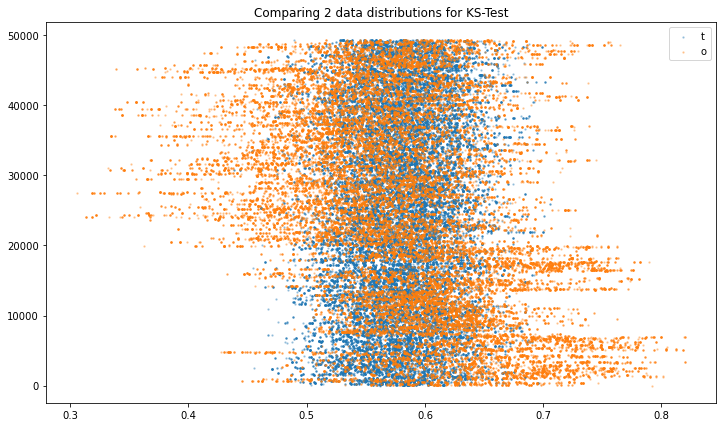

In [23]:
ks_plot_comp(base_loss_values, mixed_losses)

In [ ]:
with open("output/fgsm8_mixed.pkl", "wb") as f:
    pickle.dump(mixed_losses, f)

### apgd + Base

In [20]:
%%capture losses
!python ../run_reconstruct_mae.py --two_data_paths True --data_path1 "c:\Users\Albert Wen\ml_security\ImageNet-Data\val" --data_path2 "\\wsl$\Ubuntu\home\awen\apgd" --mask_ratio 0.75 --model pretrain_mae_base_patch16_224 --batch_size 1 --resume ../output/reconstruct_mae_pretrain_model/checkpoint-399.pth --mlp_resume ../output/reconstruct_mae_pretrain_model/mlp-checkpoint-399.pth --output_dir ../output/reconstruct_mae_pretrain_model/ --eval --num_workers 1

Epoch: [1]  [ 83824/100000]  eta: 0:06:33  loss: 0.8234 (0.6693)  acc1: 0.0000 (69.1297)  acc5: 0.0000 (77.6642)  time: 0.0233  data: 0.0002  max mem: 1721
Epoch: [1]  [ 83825/100000]  eta: 0:06:33  loss: 0.8208 (0.6693)  acc1: 0.0000 (69.1289)  acc5: 0.0000 (77.6644)  time: 0.0238  data: 0.0002  max mem: 1721
Epoch: [1]  [ 83826/100000]  eta: 0:06:33  loss: 0.8072 (0.6693)  acc1: 0.0000 (69.1281)  acc5: 0.0000 (77.6635)  time: 0.0238  data: 0.0003  max mem: 1721
Epoch: [1]  [ 83827/100000]  eta: 0:06:33  loss: 0.7955 (0.6693)  acc1: 0.0000 (69.1273)  acc5: 0.0000 (77.6626)  time: 0.0237  data: 0.0002  max mem: 1721
Epoch: [1]  [ 83828/100000]  eta: 0:06:33  loss: 0.7955 (0.6693)  acc1: 0.0000 (69.1264)  acc5: 0.0000 (77.6617)  time: 0.0238  data: 0.0002  max mem: 1721
Epoch: [1]  [ 83829/100000]  eta: 0:06:33  loss: 0.7878 (0.6693)  acc1: 0.0000 (69.1256)  acc5: 0.0000 (77.6607)  time: 0.0238  data: 0.0002  max mem: 1721
Epoch: [1]  [ 83830/100000]  eta: 0:06:33  loss: 0.7822 (0.6693)

In [21]:
output_lines = losses.stdout.split('\n')

pattern = re.compile('loss: (\d.\d*) ')

epoch_lines = [x for x in output_lines if x[0:5] == 'Epoch']
apgd_losses = [float(pattern.findall(x)[0]) for x in epoch_lines[:-1] if pattern.findall(x) != []]


Epoch: [1]  [ 84720/100000]  eta: 0:06:11  loss: 0.8124 (0.6703)  acc1: 0.0000 (68.7032)  acc5: 100.0000 (77.3622)  time: 0.0254  data: 0.0001  max mem: 1721
Epoch: [1]  [ 84721/100000]  eta: 0:06:11  loss: 0.8124 (0.6703)  acc1: 0.0000 (68.7023)  acc5: 100.0000 (77.3624)  time: 0.0259  data: 0.0001  max mem: 1721
Epoch: [1]  [ 84722/100000]  eta: 0:06:11  loss: 0.8038 (0.6703)  acc1: 0.0000 (68.7015)  acc5: 100.0000 (77.3615)  time: 0.0261  data: 0.0001  max mem: 1721
Epoch: [1]  [ 84723/100000]  eta: 0:06:11  loss: 0.7965 (0.6703)  acc1: 0.0000 (68.7007)  acc5: 100.0000 (77.3606)  time: 0.0263  data: 0.0001  max mem: 1721
Epoch: [1]  [ 84724/100000]  eta: 0:06:11  loss: 0.7965 (0.6703)  acc1: 0.0000 (68.6999)  acc5: 0.0000 (77.3597)  time: 0.0259  data: 0.0001  max mem: 1721
Epoch: [1]  [ 84725/100000]  eta: 0:06:11  loss: 0.7929 (0.6703)  acc1: 0.0000 (68.6991)  acc5: 0.0000 (77.3600)  time: 0.0260  data: 0.0001  max mem: 1721
Epoch: [1]  [ 84726/100000]  eta: 0:06:11  loss: 0.7929

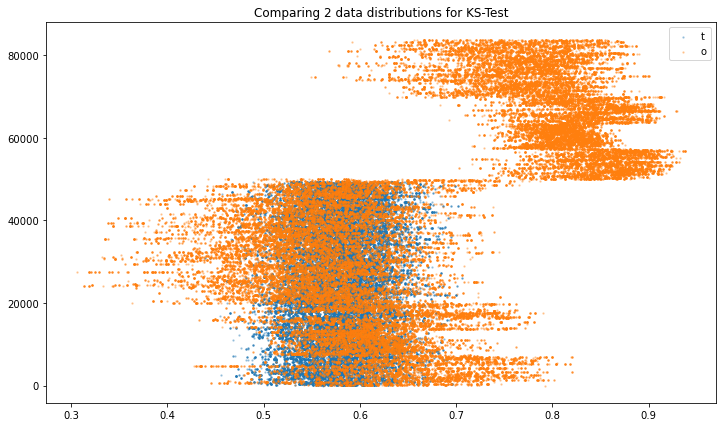

In [24]:
ks_plot_comp(base_loss_values, apgd_losses)

In [25]:
with open("output/apgd_mixed.pkl", "wb") as f:
    pickle.dump(apgd_losses, f)